In [1]:
using Graphs, 
LinearAlgebra, 
SparseArrays, 
Test, 
SimpleWeightedGraphs, 
Plots,
Distributions

In [2]:
H = 9
T = UInt32
n,m = T(512), T(256)#2^(H-1)


(0x00000200, 0x00000100)

In [3]:
g = Graphs.grid([UInt32(8), UInt32(8)])

{64, 112} undirected simple UInt32 graph

In [4]:
ℒ = Cauchy(1)

h=SimpleWeightedGraph(Graphs.grid([n,n]))
for edge in edges(h)
    add_edge!(h, src(edge), dst(edge), rand(Float16))
end
h


┌ Warning: Note: adding edges with a zero weight to this graph type has no effect.
└ @ SimpleWeightedGraphs /home/simon/.julia/packages/SimpleWeightedGraphs/E0rMD/src/simpleweightedgraph.jl:123


{262144, 523264} undirected simple UInt32 graph with Float64 weights

In [5]:
rev(i,n) = (1+((i-1)÷n), 1+(i-1)%n)
id(i,j,n) = (i-1)*n+j
#i,j = n,n
#L = id(i,j,n)
#@test rev(L,n)==(i,j)
function border(n)
    a = [(1,i) for i in 1:n]
    b = [(i,1) for i in 1:n]
    c = [(n,i) for i in 1:n]
    d = [(i,n) for i in 1:n]
    L = vcat(a,b,c,d)
    return [id(a[1],a[2],n) for a in L]
end

function diagonal(n)
    L = [(i,n-i) for i in 1:n]
    return [id(a[1], a[2], n) for a in L]
end

diagonal (generic function with 1 method)

In [6]:

D = enumerate_paths(dijkstra_shortest_paths(h,T(id(m,m,n))));
#D2 = enumerate_paths(dijkstra_shortest_paths(h,id(n,n,n)));

262144-element Vector{Vector{UInt32}}:
 [0x0001ff00, 0x0001fd00, 0x0001fb00, 0x0001f900, 0x0001f700, 0x0001f500, 0x0001f4ff, 0x0001f2ff, 0x0001f0ff, 0x0001f0fe  …  0x00000c04, 0x00000c03, 0x00000a03, 0x00000803, 0x00000603, 0x00000403, 0x00000402, 0x00000202, 0x00000201, 0x00000001]
 [0x0001ff00, 0x0001fd00, 0x0001fb00, 0x0001f900, 0x0001f700, 0x0001f500, 0x0001f4ff, 0x0001f2ff, 0x0001f0ff, 0x0001f0fe  …  0x00000c03, 0x00000a03, 0x00000803, 0x00000603, 0x00000403, 0x00000402, 0x00000202, 0x00000201, 0x00000001, 0x00000002]
 [0x0001ff00, 0x0001fd00, 0x0001fb00, 0x0001f900, 0x0001f700, 0x0001f500, 0x0001f4ff, 0x0001f2ff, 0x0001f0ff, 0x0001f0fe  …  0x00000c06, 0x00000c05, 0x00000c04, 0x00000c03, 0x00000a03, 0x00000803, 0x00000603, 0x00000403, 0x00000203, 0x00000003]
 [0x0001ff00, 0x0001fd00, 0x0001fb00, 0x0001f900, 0x0001f700, 0x0001f500, 0x0001f4ff, 0x0001f2ff, 0x0001f0ff, 0x0001f0fe  …  0x00000c05, 0x00000c04, 0x00000c03, 0x00000a03, 0x00000803, 0x00000603, 0x00000403, 0x00000203, 0x000

In [7]:
function path_to_plot(p)
    x = [(i-1)÷n for i in p]
    y = [(i-1)%n + 1 for i in p]
    return x,y
end

path_to_plot (generic function with 1 method)

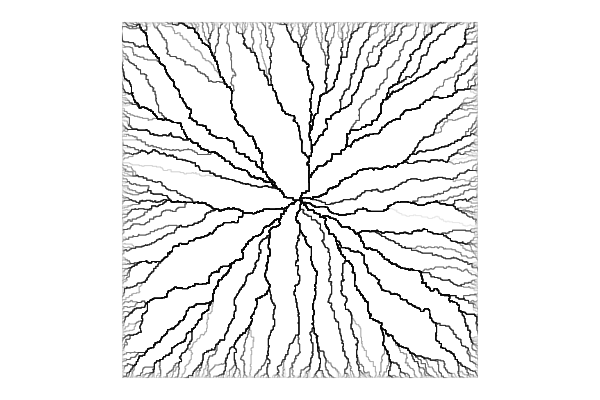

"/home/simon/Documents/simulations/fpp.pdf"

In [11]:
plt = plot(
    background_color=:white, 
    legend=:none, 
    axis=false, 
    ticks=false,
    aspect_ratio=:equal,
    figsize=(200,200)
    )
for node in border(n)
    x,y=path_to_plot(D[node])
    plot!(x,y, color=:black, lw=1, alpha=0.1)
    #x,y = path_to_plot(D2[node])
    #plot!(x,y,color=:white, lw=1, alpha=0.1)
end
display(plt)
savefig("fpp.png")
